In [230]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score,ConfusionMatrixDisplay
from sklearn.neighbors import KNeighborsClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB

In [145]:
data = pd.read_csv('data.csv')

In [4]:
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [5]:
data.tail()


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
564,926424,M,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,NaN
565,926682,M,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,NaN
566,926954,M,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,NaN
567,927241,M,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,NaN
568,92751,B,7.76,24.54,47.92,181.0,0.05263,0.04362,0.00000,0.00000,...,30.37,59.16,268.6,0.08996,0.06444,0.0000,0.0000,0.2871,0.07039,NaN


In [6]:
data.shape

(569, 33)

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [8]:
data.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [9]:
data = pd.read_csv('data.csv')

In [10]:
data.isna().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [11]:
data['diagnosis'].value_counts()

diagnosis
B    357
M    212
Name: count, dtype: int64

<Axes: xlabel='count', ylabel='diagnosis'>

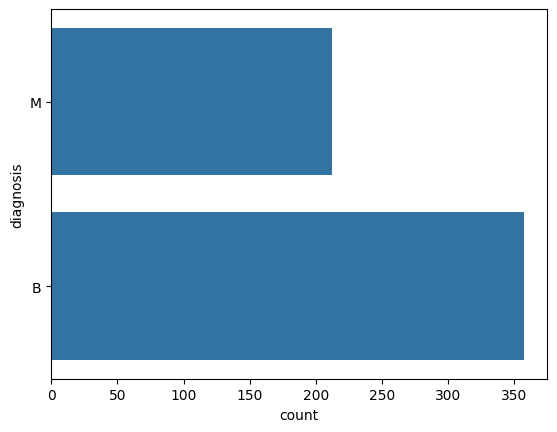

In [12]:
sns.countplot(data['diagnosis'])

In [13]:
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

In [14]:
data['diagnosis'].replace({"M":"1", "B":"0"}, inplace= True)

In [15]:
data .head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


<Axes: xlabel='count', ylabel='diagnosis'>

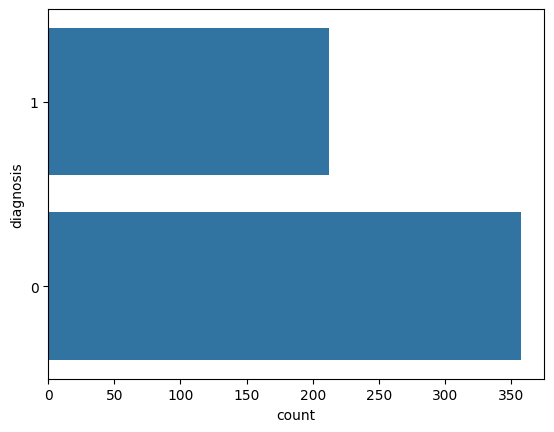

In [16]:
sns.countplot(data['diagnosis'])

In [17]:
data['diagnosis'].value_counts()

diagnosis
0    357
1    212
Name: count, dtype: int64

In [18]:
data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [19]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
id,569.0,3.037183e+07,1.250206e+08,8670.000000,869218.000000,906024.000000,8.813129e+06,9.113205e+08
radius_mean,569.0,1.412729e+01,3.524049e+00,6.981000,11.700000,13.370000,1.578000e+01,2.811000e+01
texture_mean,569.0,1.928965e+01,4.301036e+00,9.710000,16.170000,18.840000,2.180000e+01,3.928000e+01
perimeter_mean,569.0,9.196903e+01,2.429898e+01,43.790000,75.170000,86.240000,1.041000e+02,1.885000e+02
area_mean,569.0,6.548891e+02,3.519141e+02,143.500000,420.300000,551.100000,7.827000e+02,2.501000e+03
smoothness_mean,569.0,9.636028e-02,1.406413e-02,0.052630,0.086370,0.095870,1.053000e-01,1.634000e-01
compactness_mean,569.0,1.043410e-01,5.281276e-02,0.019380,0.064920,0.092630,1.304000e-01,3.454000e-01
concavity_mean,569.0,8.879932e-02,7.971981e-02,0.000000,0.029560,0.061540,1.307000e-01,4.268000e-01
concave points_mean,569.0,4.891915e-02,3.880284e-02,0.000000,0.020310,0.033500,7.400000e-02,2.012000e-01
symmetry_mean,569.0,1.811619e-01,2.741428e-02,0.106000,0.161900,0.179200,1.957000e-01,3.040000e-01


In [20]:
sns.pairplot(data, hue='diagnosis')

<Axes: >

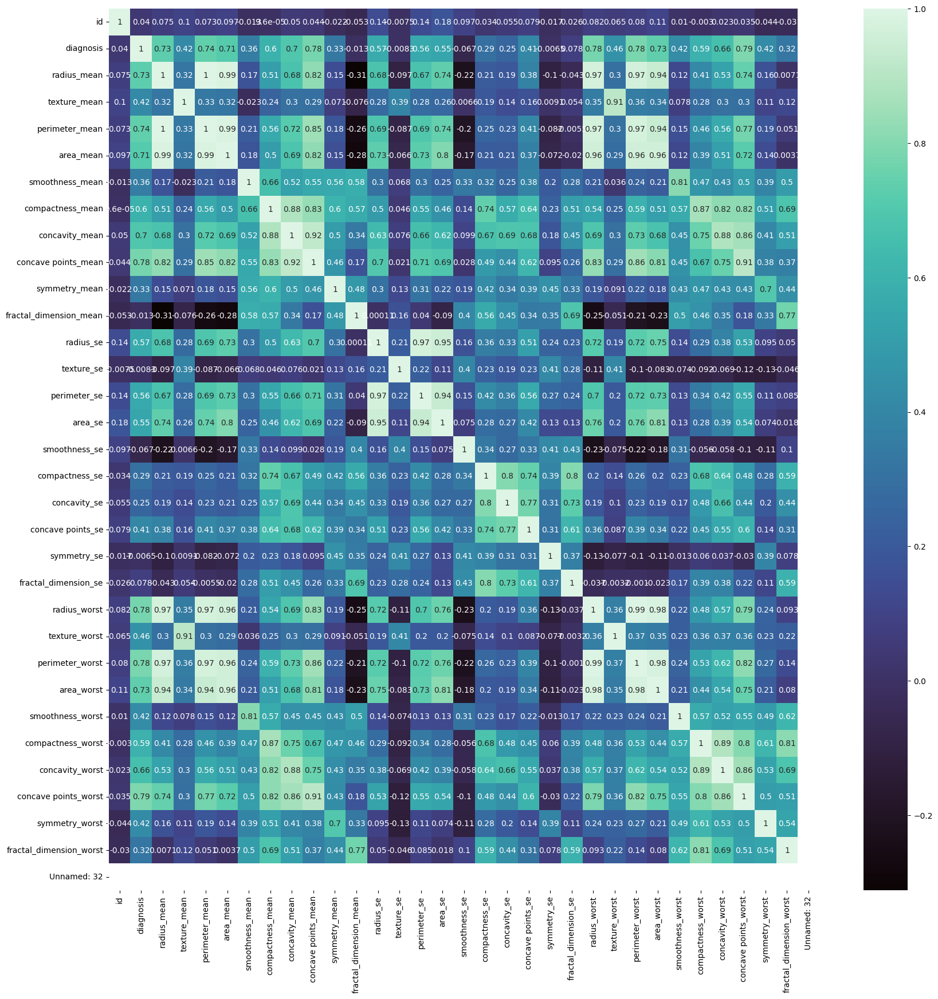

In [21]:
plt.figure(figsize=(20,20))
sns.heatmap(data.corr(),annot=True ,cmap="mako")

In [81]:
X=data.drop(['diagnosis'], axis=1)
y=data['diagnosis']

In [82]:
X_train_filled_zero = X_train.fillna(0)

In [83]:
X_train ,X_test,y_train , y_test= train_test_split(X,y,test_size=0.20, random_state=2)

In [84]:
print(X_train.isnull().sum())

id                           0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed: 32                455
dtype: i

In [85]:
print(X_test.sum())

id                         3.147751e+09
radius_mean                1.624423e+03
texture_mean               2.161360e+03
perimeter_mean             1.058783e+04
area_mean                  7.617870e+04
smoothness_mean            1.113441e+01
compactness_mean           1.229891e+01
concavity_mean             1.107838e+01
concave points_mean        6.001393e+00
symmetry_mean              2.086180e+01
fractal_dimension_mean     7.176180e+00
radius_se                  4.968770e+01
texture_se                 1.405076e+02
perimeter_se               3.495427e+02
area_se                    5.013130e+03
smoothness_se              8.290800e-01
compactness_se             3.014483e+00
concavity_se               4.067834e+00
concave points_se          1.423908e+00
symmetry_se                2.365671e+00
fractal_dimension_se       4.560733e-01
radius_worst               1.893597e+03
texture_worst              2.876230e+03
perimeter_worst            1.250042e+04
area_worst                 1.060073e+05


In [96]:
X_train_filled_zero = X_train.fillna(0)

In [97]:

X_train = X_train_filled_zero

In [86]:
print (X.shape, X_train.shape, X_test.shape)

(569, 32) (455, 32) (114, 32)


In [90]:
imputer = SimpleImputer(strategy='mean')

In [91]:
X_train_imputed = imputer.fit_transform(X_train)

C:\Users\soft\PycharmProjects\Ml\venv\lib\site-packages\sklearn\impute\_base.py:558: UserWarning: Skipping features without any observed values: ['Unnamed: 32']. At least one non-missing value is needed for imputation with strategy='mean'.
  warnings.warn(


In [92]:
X_train_no_na = X_train.dropna()
y_train_no_na = y_train.loc[X_train_no_na.index]

In [99]:
model = LogisticRegression()

In [100]:
#traing the logistic Regression Model ussing  traing data 

model.fit(X_train, y_train)

LogisticRegression()

Model Evaluation


Accuracy Score


In [103]:
# accuracy on training data 
X_train_prediction = model.predict(X_train)
training_data_accuracy = accuracy_score(y_train, X_train_prediction)

In [110]:
# Create a StandardScaler
s = StandardScaler()

# Fit and transform the scaler on the training data
X_train_scaled = s.fit_transform(X_train)

# Use the same scaler to transform the testing data
X_test_scaled = s.transform(X_test)

In [117]:
X_train_imputed = imputer.fit_transform(X_train_scaled)

In [118]:
X_test_imputed = imputer.transform(X_test_scaled)

In [120]:
# Check for NaN values in the NumPy array
nan_values = np.isnan(X_test_imputed)

# Count the number of NaN values along each column
nan_count_per_column = np.sum(nan_values, axis=0)

In [121]:
# Print the count of NaN values for each column
print("Number of NaN values per column:")
print(nan_count_per_column)

Number of NaN values per column:
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


In [125]:
X_test_imputed_df = pd.DataFrame(X_test_imputed, columns=nan_count_per_column )

In [126]:
print(X_test_imputed_df.isnull().sum())

0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
0    0
dtype: int64


In [129]:
# Create an imputer with the same strategy used for training data
imputer = SimpleImputer(strategy='mean')

# Fit and transform on the training data
X_train_imputed = imputer.fit_transform(X_train_scaled)

# Transform the testing data using the same imputer
X_test_imputed = imputer.transform(X_test_scaled)


In [131]:
# Identify rows with missing values in the training data
rows_without_nan = ~np.isnan(X_train_scaled).any(axis=1)

# Use boolean indexing to select rows without missing values
X_train_cleaned = X_train_scaled[rows_without_nan]
y_train_cleaned = y_train[rows_without_nan]

In [132]:
# Identify rows with missing values in the testing data
rows_without_nan_test = ~np.isnan(X_test_scaled).any(axis=1)

# Use boolean indexing to select rows without missing values
X_test_cleaned = X_test_scaled[rows_without_nan_test]
y_test_cleaned = y_test[rows_without_nan_test]

In [135]:


# Create the logistic regression model
logmodel = LogisticRegression()

# Fit the model to the training data
logmodel.fit(X_train_imputed, y_train)

# Predict on the testing data
pred = logmodel.predict(X_test_imputed)


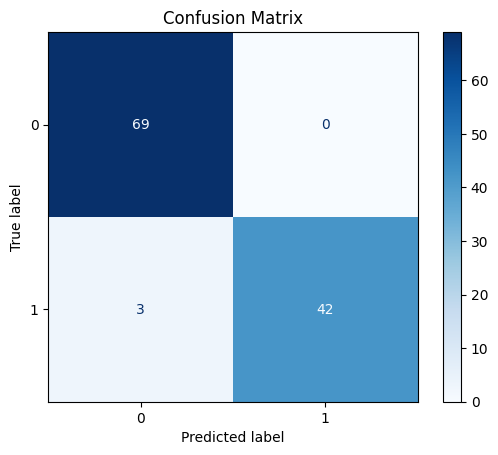

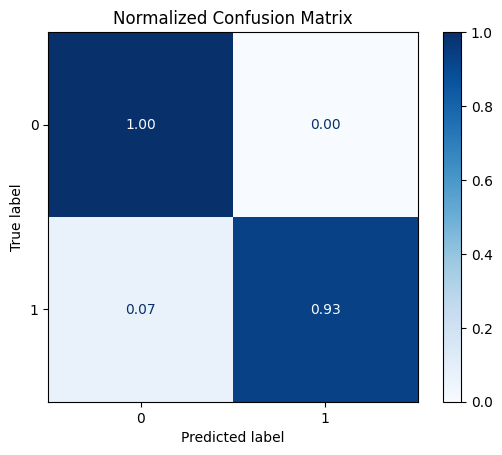

In [209]:
# Create confusion matrix

cm = confusion_matrix(y_test, pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=logmodel.classes_)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

#Normalized Matrix 
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
disp_normalized = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=logmodel.classes_)
disp_normalized.plot(cmap='Blues', values_format='.2f')
plt.title('Normalized Confusion Matrix')
plt.show()  

In [171]:
print(confusion_matrix(y_test, pred))
print (classification_report(y_test,pred))
print(accuracy_score(y_test,pred))

[[69  0]
 [ 3 42]]
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        69
           1       1.00      0.93      0.97        45

    accuracy                           0.97       114
   macro avg       0.98      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

0.9736842105263158


Accuracy: 0.5789473684210527
Classification Report:
               precision    recall  f1-score   support

           0       0.64      0.73      0.68        71
           1       0.42      0.33      0.37        43

    accuracy                           0.58       114
   macro avg       0.53      0.53      0.53       114
weighted avg       0.56      0.58      0.57       114



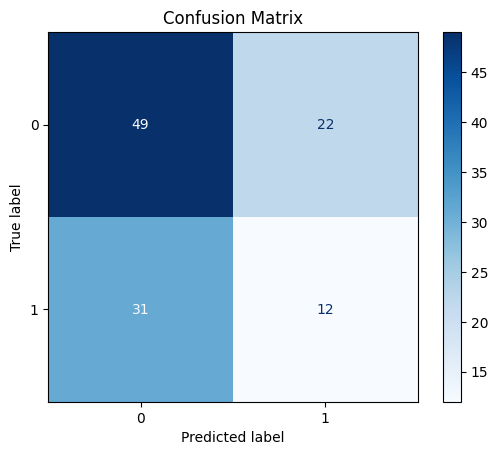

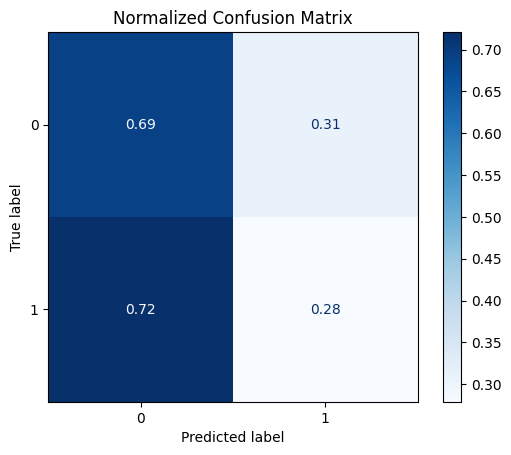

In [221]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Create KNN Classifier model
k = 3  # Set the number of neighbors (you can adjust this)
knn = KNeighborsClassifier(n_neighbors=k)

# Train the model
knn.fit(X_train_imputed, y_train)

# Make predictions on the test set
yk_pred = knn.predict(X_test_imputed)

# Evaluate the model
accuracy = accuracy_score(y_test, yk_pred)
print(f'Accuracy: {accuracy}')

# Display classification report
print('Classification Report:\n', classification_report(y_test, yk_pred))

# Calculate and display confusion matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=knn.classes_)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

# Calculate and display normalized confusion matrix

disp_normalized = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=knn.classes_)
disp_normalized.plot(cmap='Blues', values_format=".2f")
plt.title('Normalized Confusion Matrix')
plt.show()

In [202]:
print(confusion_matrix(y_test, pred))
print (classification_report(y_test,pred))
print(accuracy_score(y_test,pred))

[[69  0]
 [ 3 42]]
              precision    recall  f1-score   support

           0       0.96      1.00      0.98        69
           1       1.00      0.93      0.97        45

    accuracy                           0.97       114
   macro avg       0.98      0.97      0.97       114
weighted avg       0.97      0.97      0.97       114

0.9736842105263158


Accuracy: 0.5350877192982456
Classification Report:
               precision    recall  f1-score   support

           0       0.61      0.69      0.65        71
           1       0.35      0.28      0.31        43

    accuracy                           0.54       114
   macro avg       0.48      0.48      0.48       114
weighted avg       0.51      0.54      0.52       114



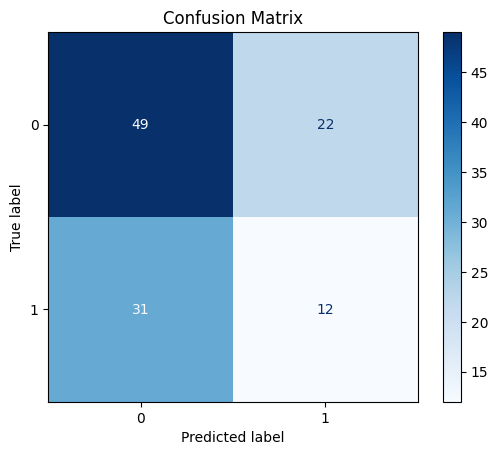

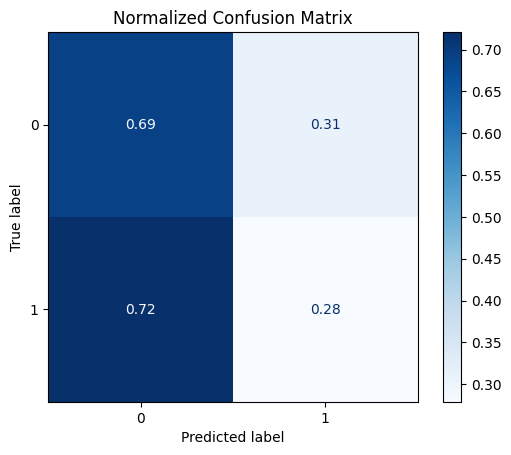

In [217]:

# Create Random Forest Classifier model
rfc = RandomForestClassifier(n_estimators=100, random_state=42)  # You can adjust n_estimators as needed

# Train the model
rfc.fit(X_train_imputed, y_train)

# Make predictions on the test set
y_pred = rfc.predict(X_test_imputed)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy}')

# Display classification report
print('Classification Report:\n', classification_report(y_test, y_pred))

# Calculate and display confusion matrix
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=rfc.classes_)
disp.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

# Calculate and display normalized confusion matrix
cm_normalized = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
disp_normalized = ConfusionMatrixDisplay(confusion_matrix=cm_normalized, display_labels=rfc.classes_)
disp_normalized.plot(cmap='Blues', values_format=".2f")
plt.title('Normalized Confusion Matrix')
plt.show()

KNN Accuracy: 0.5789473684210527
KNN Classification Report:
               precision    recall  f1-score   support

           0       0.64      0.73      0.68        71
           1       0.42      0.33      0.37        43

    accuracy                           0.58       114
   macro avg       0.53      0.53      0.53       114
weighted avg       0.56      0.58      0.57       114

RFC Accuracy: 0.5350877192982456
RFC Classification Report:
               precision    recall  f1-score   support

           0       0.61      0.69      0.65        71
           1       0.35      0.28      0.31        43

    accuracy                           0.54       114
   macro avg       0.48      0.48      0.48       114
weighted avg       0.51      0.54      0.52       114



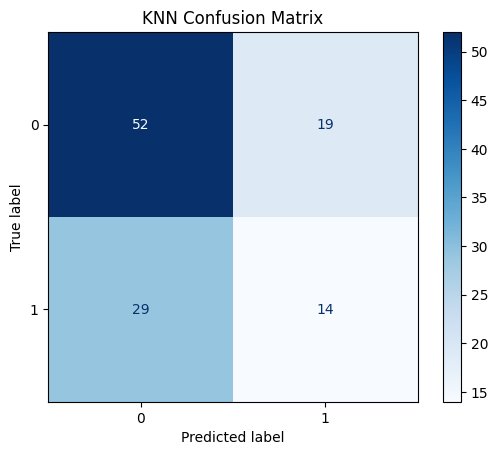

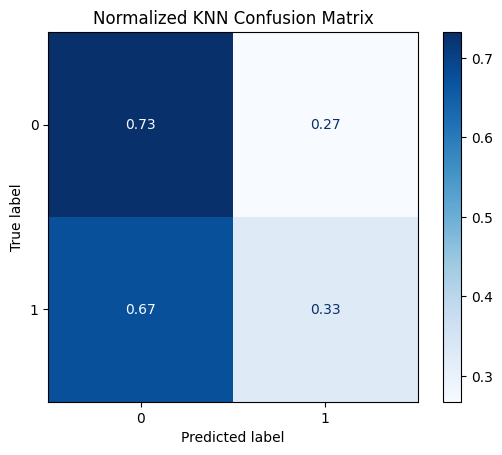

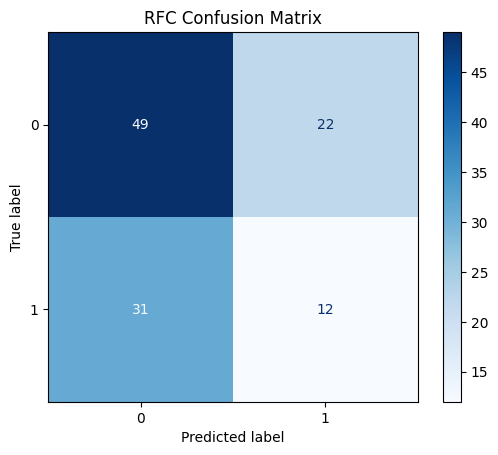

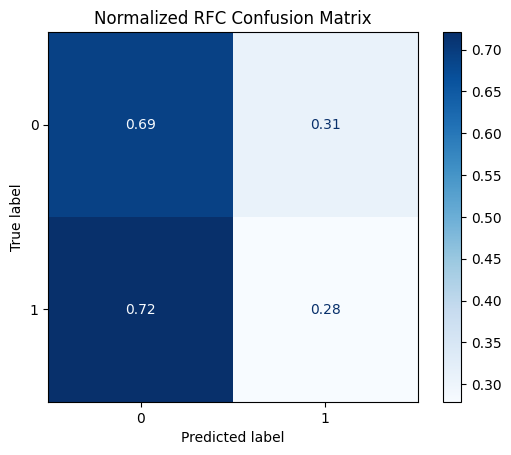

In [226]:


# Create KNN Classifier model
k = 3  # Set the number of neighbors (you can adjust this)
knn = KNeighborsClassifier(n_neighbors=k)

# Train the KNN model
knn.fit(X_train_imputed, y_train)

# Make predictions on the test set
y_pred_knn = knn.predict(X_test_imputed)

# Create RFC model
rfc = RandomForestClassifier(n_estimators=100, random_state=42)  # You can adjust n_estimators as needed

# Train the RFC model
rfc.fit(X_train_imputed, y_train)

# Make predictions on the test set
y_pred_rfc = rfc.predict(X_test_imputed)

# Evaluate the KNN model
accuracy_knn = accuracy_score(y_test, y_pred_knn)
print(f'KNN Accuracy: {accuracy_knn}')

# Display KNN classification report
print('KNN Classification Report:\n', classification_report(y_test, y_pred_knn))

# Evaluate the RFC model
accuracy_rfc = accuracy_score(y_test, y_pred_rfc)
print(f'RFC Accuracy: {accuracy_rfc}')

# Display RFC classification report
print('RFC Classification Report:\n', classification_report(y_test, y_pred_rfc))

# Calculate and display KNN confusion matrix
cm_knn = confusion_matrix(y_test, y_pred_knn)
disp_knn = ConfusionMatrixDisplay(confusion_matrix=cm_knn, display_labels=knn.classes_)
disp_knn.plot(cmap='Blues')
plt.title('KNN Confusion Matrix')
plt.show()


# Calculate and display normalized KNN confusion matrix
cm_normalized_knn = cm_knn.astype('float') / cm_knn.sum(axis=1)[:, np.newaxis]
disp_normalized_knn = ConfusionMatrixDisplay(confusion_matrix=cm_normalized_knn, display_labels=knn.classes_)
disp_normalized_knn.plot(cmap='Blues', values_format=".2f")
plt.title('Normalized KNN Confusion Matrix')
plt.show()
# Calculate and display RFC confusion matrix
cm_rfc = confusion_matrix(y_test, y_pred_rfc)
disp_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_rfc, display_labels=rfc.classes_)
disp_rfc.plot(cmap='Blues')
plt.title('RFC Confusion Matrix')
plt.show()
# Calculate and display normalized RFC confusion matrix
cm_normalized_rfc = cm_rfc.astype('float') / cm_rfc.sum(axis=1)[:, np.newaxis]
disp_normalized_rfc = ConfusionMatrixDisplay(confusion_matrix=cm_normalized_rfc, display_labels=rfc.classes_)
disp_normalized_rfc.plot(cmap='Blues', values_format=".2f")
plt.title('Normalized RFC Confusion Matrix')
plt.show()

DT Accuracy: 0.43859649122807015
DT Classification Report:
               precision    recall  f1-score   support

           0       0.56      0.48      0.52        71
           1       0.30      0.37      0.33        43

    accuracy                           0.44       114
   macro avg       0.43      0.43      0.42       114
weighted avg       0.46      0.44      0.45       114



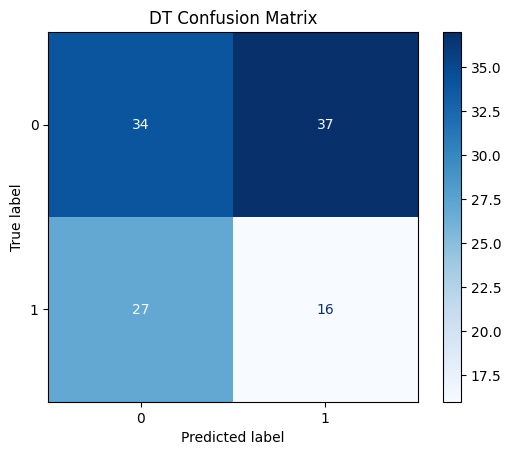

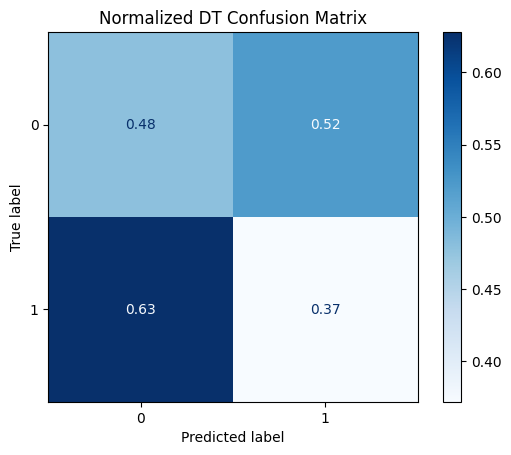

In [229]:

# Create Decision Tree Classifier model
dt = DecisionTreeClassifier(random_state=42)

# Train the model
dt.fit(X_train_imputed, y_train)

# Make predictions on the test set
y_pred_dt = dt.predict(X_test_imputed)

# Evaluate the model
accuracy_dt = accuracy_score(y_test, y_pred_dt)
print(f'DT Accuracy: {accuracy_dt}')

# Display classification report
print('DT Classification Report:\n', classification_report(y_test, y_pred_dt))

# Calculate and display confusion matrix
cm_dt = confusion_matrix(y_test, y_pred_dt)
disp_dt = ConfusionMatrixDisplay(confusion_matrix=cm_dt, display_labels=dt.classes_)
disp_dt.plot(cmap='Blues')
plt.title('DT Confusion Matrix')
plt.show()

# Calculate and display normalized confusion matrix
cm_normalized_dt = cm_dt.astype('float') / cm_dt.sum(axis=1)[:, np.newaxis]
disp_normalized_dt = ConfusionMatrixDisplay(confusion_matrix=cm_normalized_dt, display_labels=dt.classes_)
disp_normalized_dt.plot(cmap='Blues', values_format=".2f")
plt.title('Normalized DT Confusion Matrix')
plt.show()